# Przetwarzanie podstawowe

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from skimage import io, feature, color, filters, morphology, exposure
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVC
from sklearn import metrics
from sklearn.pipeline import make_pipeline
from sklearn.model_selection import GridSearchCV
from PIL import Image, ImageFile
ImageFile.LOAD_TRUNCATED_IMAGES = True

In [2]:
def contrast(img, min_perc, max_perc):
  min_val = np.percentile(img, min_perc)
  max_val = np.percentile(img, max_perc)
  norm = (img - min_val) / (max_val - min_val)
  norm[norm[:, :] > 1] = 1
  norm[norm[:, :] < 0] = 0
  return norm

In [3]:
def preprocess(img):
    print("Preprocessing...")

    # Consider Green channel
    img_g = img[:, :, 1]

    # Set black pixels to zero
    mask = img[:, :, 0] > 10
    img_g = img_g * mask

    # Create binary mask for eye
    mask = morphology.binary_erosion(mask * 1, selem=np.ones((15, 15)))
    mask[:20, :] = 0
    mask[-20:, :] = 0

    # Contrast stretching
    p1, p99 = np.percentile(img_g[np.nonzero(img_g)], (1, 99))
    img_rescale = exposure.rescale_intensity(img_g, in_range=(p1, p99))

    # Adaptive Equalization
    img_adapteq = exposure.equalize_adapthist(img_rescale, clip_limit=0.07)

    frangi = filters.frangi(img_adapteq)

    # Closing
    closing = morphology.closing(frangi)

    # Equalize Histogram
    eq_hist = exposure.equalize_hist(closing)

    # Erosion
    erosion = morphology.erosion(morphology.erosion(morphology.erosion(eq_hist)))

    threshold = (erosion > 0.85) * 1

    # Apply binary mask from preprocessing
    masked = threshold * mask

    # Dilatation
    binary_output = morphology.binary_dilation(masked)

    return erosion

In [4]:
def pipeline(img):
  img[:, :, 0] = 0
  img[:,:,2] = 0
  img = color.rgb2gray(contrast(img, 0.28, 98))
  img_ded = feature.canny(img, 2)
  img_ded = morphology.dilation(img_ded, morphology.disk(3))
  return [img, img_ded]

In [5]:
def accuracy(ded, ref):
  ded = ded.astype(int)
  ref = ref.astype(int)
  if (np.max(ref) == 255):
    ref = ref/255
  if (np.max(ded) == 255):
    ded = ded/255
  if ded.ndim == 2:
    N = ded.shape[0]*ded.shape[1]
  else:
    N = ded.shape[0]
  accuracy = (ded == ref).sum() / N
  return accuracy

In [6]:
def sensitivity(ded, ref):
  
  ded = ded.astype(int)
  ref = ref.astype(int)
  if (np.max(ref) == 255):
    ref = ref/255
  if (np.max(ded) == 255):
    ded = ded/255
  if ded.ndim == 2:
    N = ded.shape[0]*ded.shape[1]
  else:
    N = ded.shape[0]
  TP = ((ded == 1) & (ref == 1)).sum()
  FP = ((ded == 1) & (ref == 0)).sum()
  precision = TP / (TP+FP)
  return precision

In [7]:
def specificity(ded, ref):
  ded = ded.astype(int)
  ref = ref.astype(int)
  if (np.max(ref) == 255):
    ref = ref/255
  if (np.max(ded) == 255):
    ded = ded/255
  if ded.ndim == 2:
    N = ded.shape[0]*ded.shape[1]
  else:
    N = ded.shape[0]
  TN = ((ded == 0) & (ref == 1)).sum()
  FP = ((ded == 1) & (ref == 0)).sum()
  return (TN / (TN + FP))


In [8]:
def geo_mean(ded, ref):
  return np.sqrt(sensitivity(ded, ref)*specificity(ded, ref))

In [9]:
def arth_mean(ded, ref):
  return (sensitivity(ded, ref)+specificity(ded, ref))/2

In [10]:
def gen_confusion_matrix(img, ref):
  result = np.zeros([img.shape[0], img.shape[1], 3], dtype=np.uint8)
  result[(img == True) & (ref == True), :] = 255
  result[(img == False) & (ref == True)] =(255, 0, 0) 
  result[(img == True) & (ref == False)] =(0, 255, 0) 

  return result

In [25]:
def visualize(img_path, ref_img_path):
  fig, ((ax1, ax3), (ax2, ax4)) = plt.subplots(2, 2, figsize=(10, 10))
  img = io.imread(img_path)
  ax1.imshow(img, cmap=plt.cm.Greys_r)
  ax1.set_title('original')
  ref = io.imread(ref_img_path)
  li = pipeline(img)
  
  ax2.imshow(gen_confusion_matrix(li[1].astype(bool), ref.astype(bool)))
  ax2.set_title('Confusions')
  ax3.imshow(ref, cmap=plt.cm.Greys_r)
  ax3.set_title('Ground_truth')
  ax4.imshow(li[1], cmap=plt.cm.Greys_r)
  ax4.set_title('Effect')
  '''print("Accuracy: ", accuracy(li[1], ref))
  print("Sensitivity: ", sensitivity(li[1], ref))
  print("Specifity: ", specificity(li[1], ref))
  print("Geometric mean: ", geo_mean(li[1], ref))
  print("Arthmetic mean: ", arth_mean(li[1], ref))'''
  tn, fp, fn, tp = metrics.confusion_matrix(li[1].astype(bool).ravel(), ref.astype(bool).ravel()).ravel()
  
  acuracy = (tp + tn) / (tp + tn + fp + fn)
  precision = tp / (tp + fp)
  sensivity = tp / (tp + fn)
  specificity = tn / (tn + fp)
  g_mean1 = (precision * sensivity) ** (1 / 2)
  g_mean2 = (sensivity * specificity) ** (1 / 2)
  print("Accuracy:", acuracy)
  print("Precision:", precision)
  print("Sensivity:", sensivity)
  print("Specificity:", specificity)
  print("Średnia geometryczna = sqrt(precision * sensivity):", g_mean1)
  print("Średnia geometryczna = sqrt(sensivity * specificity):", g_mean2)

Accuracy: 0.9028639480515419
Precision: 0.23687877832641818
Sensivity: 0.5365781035904025
Specificity: 0.919847769809298
Średnia geometryczna = sqrt(precision * sensivity): 0.3565164311153145
Średnia geometryczna = sqrt(sensivity * specificity): 0.7025454945525835


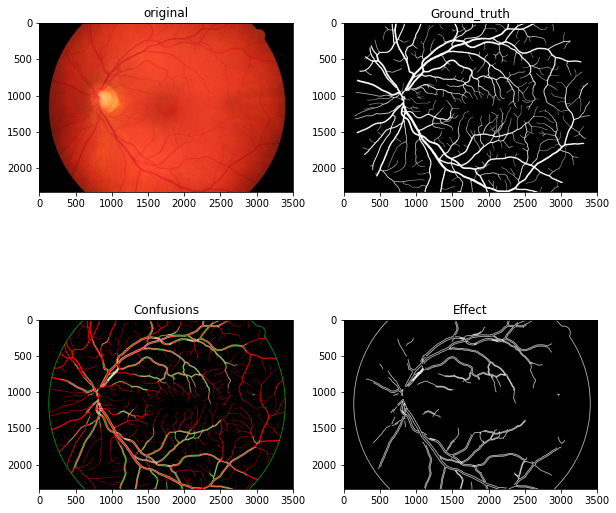

In [30]:
visualize('08_h.jpg', '08_h.tif')

# Przetwarzanie ML

In [ ]:
from sklearn import svm
from skimage import measure
from scipy.fft import dctn, idctn
import cv2

In [ ]:
def sample_imgage(img, ref, n = 1000, percent = 50):
  #diag_p = [[0,0], [1,1], [2,2], [3,3], [4,4], [0,4], [1,3], [3,1], [4,0]]
  diag_p = [(0,1,2, 3, 4, 0, 1, 3, 4), (0, 1, 2, 3, 4, 4, 3, 1, 0)]
  vessels_num = np.sum(ref)
  features = np.zeros((n,11), dtype=np.float64)
  labels = np.zeros(n, dtype=bool)
  des_num_neg = int(np.floor(n*percent/100))
  des_num_pos = int(np.ceil(n*(100-percent)/100))
  num_pos = 0
  num_neg = 0
  positives = np.where(ref == 255)
  points = np.vstack((positives[0], positives[1])).T
  points = points[:][np.where(np.logical_and
                              (points[:,0]>2, points[:, 0]+4<ref.shape[0]))]
  points = points[:][np.where(np.logical_and
                              (points[:,1]>2, points[:, 1]+4<ref.shape[1]))]
  ind = np.random.choice(points.shape[0], des_num_pos)
  positive_points = points[:][ind]
  negatives = np.where(ref == 0)
  points = np.vstack((negatives[0], negatives[1])).T
  points = points[:][np.where(np.logical_and
                              (points[:,0]>2, points[:, 0]+4<ref.shape[0]))]
  points = points[:][np.where(np.logical_and
                              (points[:,1]>2, points[:, 1]+4<ref.shape[1]))]
  ind = np.random.choice(points.shape[0], des_num_neg)
  negative_points = points[:][ind]

  points = np.concatenate((positive_points, negative_points))
  i = 0 
  for p in points[:]:
    features[i, 0] = img[p[0], p[1]]
    features[i, 1] = np.mean(img[(p[0]-2):(p[0]+3), (p[1]-2):(p[1]+3)])
    features[i, 2] = np.std(img[(p[0]-2):(p[0]+3), (p[1]-2):(p[1]+3)])
    #features[i, 3] = np.sum((img[(p[0]-2):(p[0]+3), (p[1]-2):(p[1]+3)])[diag_p])
    #print((img[(p[0]-2):(p[0]+3), (p[1]-2):(p[1]+3)])[diag_p])
    hu = cv2.HuMoments(cv2.moments(img[(p[0]-2):(p[0]+3), (p[1]-2):(p[1]+3)]))
    for j in range(0, 7):
        f  = -1 * np.sign(hu[j]) * np.log10(np.abs(hu[j]))
        if not np.isnan(f):
            features[i, j+3] = f
        else:
            features[i, j+3] = np.nan_to_num(f)
    features[i, 10] = np.sum(dctn(img[(p[0]-2):(p[0]+3), (p[1]-2):(p[1]+3)])[diag_p])
    if ref[p[0], p[1]] == 255:
      labels[i] = True
    else:
      labels[i] = False
    i+=1
  return [features, labels]

In [ ]:
def preprocess(img):
  img[:, :, 0] = 0
  img[:,:,2] = 0
  img = color.rgb2gray(contrast(img, 0.28, 98))
  return img

In [ ]:
def build_training_set(img_names, n):
  data = []
  labels = []
  samples = []
  for name in img_names:
    img = io.imread(name)
    img = preprocess(img)
    ref = io.imread(name[:name.find('.')]+ '.tif')
    samples.append(sample_imgage(img, ref, int(n/len(img_names)), 80))

  data = samples[0][0]
  labels = samples[0][1]
  for i in samples[1:]:
    data = np.concatenate((i[0], data))
    labels = np.concatenate((i[1], labels))

  return [data, labels]



In [ ]:
def train_classifier(img_names, n):
  ds = build_training_set(img_names, n)
  clf = make_pipeline(StandardScaler(), SVC(gamma='auto', kernel='rbf', probability=False))
  clf.fit(ds[0], ds[1])
  return clf

In [ ]:
def test_clasiffier(img, clf):
  ds = build_training_set([img], 10000)
  result = clf.predict(ds[0])

  tn, fp, fn, tp = metrics.confusion_matrix(result.astype(bool).ravel(), ds[1].astype(bool).ravel()).ravel()
  acuracy = (tp + tn) / (tp + tn + fp + fn)
  precision = tp / (tp + fp)
  sensivity = tp / (tp + fn)
  specificity = tn / (tn + fp)
  g_mean1 = (precision * sensivity) ** (1 / 2)
  g_mean2 = (sensivity * specificity) ** (1 / 2)
  print(" ")
  print("Wyniki modelu:")
  print("Accuracy:", acuracy)
  print("Precision:", precision)
  print("Sensivity:", sensivity)
  print("Specificity:", specificity)
  print("Średnia geometryczna = sqrt(precision * sensivity):", g_mean1)
  print("Średnia geometryczna = sqrt(sensivity * specificity):", g_mean2)

In [ ]:
def get_data(x, y, img):
  diag_p = [(0,1,2, 3, 4, 0, 1, 3, 4), (0, 1, 2, 3, 4, 4, 3, 1, 0)]

  data = []
  data.append(img[x, y])
  data.append(np.mean(img[(x-2):(x+3), (y-2):(y+3)]))
  data.append(np.std(img[(x-2):(x+3), (y-2):(y+3)]))
  hu = cv2.HuMoments(cv2.moments(img[(x-2):(x+3), (y-2):(y+3)]))
  for j in range(0, 7):
    f  = -1 * np.sign(hu[j]) * np.log10(np.abs(hu[j]))
    if not np.isnan(f):
      data.append(f)
    else:
      data.append(np.nan_to_num(f))
  data.append(np.sum(dctn(img[(x-2):(x+3), (y-2):(y+3)])[diag_p]))
  return data

In [ ]:
def visualise_clf(clf, img, ref):
  print('transforming img')
  diag_p = [(0,1,2, 3, 4, 0, 1, 3, 4), (0, 1, 2, 3, 4, 4, 3, 1, 0)]

  test_set = []
  img = io.imread(img)
  preprocessed_img = preprocess(img)
  ml_output = np.zeros(preprocessed_img.shape)
  for x in range(2, preprocessed_img.shape[0] - 4):
    print(x)
    test_set.clear()
    for y in range(2, preprocessed_img.shape[1] - 4):
      test_set.append(get_data(x, y, preprocessed_img))
    predicted_forest = clf.predict(test_set)
    ml_output[x, 2:-4] = predicted_forest.ravel()
  fig, ((ax1, ax3), (ax2, ax4)) = plt.subplots(2, 2, figsize=(10, 10))
  ax1.imshow(ml_output, cmap=plt.cm.Greys_r)


# Code

In [13]:
from IPython.display import display
from ipywidgets import FileUpload
import ipywidgets as widgets
from IPython.display import clear_output
from google.colab import files


In [14]:
def start_basic_processing():
  display(widgets.Text('Obraz do przetworzenia:'))
  upload = files.upload()
  display(upload)
  display(widgets.Text('Maska ekspercka:'))
  upload1 = files.upload()
  display(upload1)
  button = widgets.Button(description="Rozpocznij")
  output = widgets.Output()
  display(button, output)
  def on_button_clicked(b):
    with output:
      for fn in upload.keys():
        name  = fn
      for fn in upload1.keys():
        name_ref = fn
      visualize(name, name_ref)
  button.on_click(on_button_clicked)




In [15]:
def start_ml_processing():
  display(widgets.Text('Obraz do zbioru uczącego:'))
  upload = files.upload()
  #display(upload)
  display(widgets.Text('Obraz do zbioru testowego:'))
  upload1 = files.upload()
  #display(upload1)
  num =  widgets.Textarea(
  value='1000',
  description='Liczba punktów użyta do trenowania:',
  disabled=False,
  style = {'description_width': 'initial'})
  display(num)
  whole_image = widgets.Checkbox(
    value=False,
    description='Przetwarznie całego obrazu(może zająć nawet do godziny!)',
    disabled=False,
    indent=False,
    style = {'description_width': 'initial'}
)
  display(whole_image)
  button = widgets.Button(description="Rozpocznij")
  output = widgets.Output()
  display(button, output)
  trainig_imgs = []
  test_img = 0
  def on_button_clicked(b):
    print('Training cassifier')
    with output:
      
      for fn in upload.keys():
        if (fn[fn.find('.')+1:] == 'jpg'):
          trainig_imgs.append(fn)
        
      for fn in upload1.keys():
        if (fn[fn.find('.')+1:] == 'jpg'):
          test_img = fn
      print(trainig_imgs)
      clf = train_classifier(trainig_imgs, int(num.value))
      metrics = test_clasiffier(test_img, clf)
      if whole_image.value == True:
        visualise_clf(clf, test_img, 1)
      '''print("Accuracy:", metrics[0])
      print("Precision:", metrics[1])
      print("Sensivity:", metrics[2])
      print("Specificity:", metrics[3])
      print("Średnia geometryczna = sqrt(precision * sensivity):", metrics[4])
      print("Średnia geometryczna = sqrt(sensivity * specificity):", metrics[5])'''

  button.on_click(on_button_clicked)





In [16]:
clf = train_classifier(['01_h.jpg', '02_h.jpg', '03_h.jpg'], 30000)
test_clasiffier('04_h.jpg', clf)


NameError: ignored

In [ ]:
visualise_clf(clf, '04_h.jpg', 1)

# New Section

In [ ]:
from sklearn import svm
from skimage import measure
from scipy.fft import dctn, idctn
import cv2

In [ ]:
img = io.imread('01_h.jpg')
ref = io.imread('01_h.tif')
img[:, :, 0] = 0
img[:,:,2] = 0
img = color.rgb2gray(contrast(img, 0, 100))

In [ ]:
def sample_imgage(img, ref, n = 1000, percent = 50):
  #diag_p = [[0,0], [1,1], [2,2], [3,3], [4,4], [0,4], [1,3], [3,1], [4,0]]
  diag_p = [(0,1,2, 3, 4, 0, 1, 3, 4), (0, 1, 2, 3, 4, 4, 3, 1, 0)]
  vessels_num = np.sum(ref)
  features = np.zeros((n,11), dtype=np.float64)
  labels = np.zeros(n, dtype=bool)
  des_num_neg = int(np.floor(n*percent/100))
  des_num_pos = int(np.ceil(n*(100-percent)/100))
  num_pos = 0
  num_neg = 0
  positives = np.where(ref == 255)
  points = np.vstack((positives[0], positives[1])).T
  points = points[:][np.where(np.logical_and
                              (points[:,0]>2, points[:, 0]+4<ref.shape[0]))]
  points = points[:][np.where(np.logical_and
                              (points[:,1]>2, points[:, 1]+4<ref.shape[1]))]
  ind = np.random.choice(points.shape[0], des_num_pos)
  positive_points = points[:][ind]
  negatives = np.where(ref == 0)
  points = np.vstack((negatives[0], negatives[1])).T
  points = points[:][np.where(np.logical_and
                              (points[:,0]>2, points[:, 0]+4<ref.shape[0]))]
  points = points[:][np.where(np.logical_and
                              (points[:,1]>2, points[:, 1]+4<ref.shape[1]))]
  ind = np.random.choice(points.shape[0], des_num_neg)
  negative_points = points[:][ind]

  points = np.concatenate((positive_points, negative_points))
  i = 0 
  for p in points[:]:
    features[i, 0] = img[p[0], p[1]]
    features[i, 1] = np.mean(img[(p[0]-2):(p[0]+3), (p[1]-2):(p[1]+3)])
    features[i, 2] = np.std(img[(p[0]-2):(p[0]+3), (p[1]-2):(p[1]+3)])
    #features[i, 3] = np.sum((img[(p[0]-2):(p[0]+3), (p[1]-2):(p[1]+3)])[diag_p])
    #print((img[(p[0]-2):(p[0]+3), (p[1]-2):(p[1]+3)])[diag_p])
    hu = cv2.HuMoments(cv2.moments(img[(p[0]-2):(p[0]+3), (p[1]-2):(p[1]+3)]))
    for j in range(0, 7):
      f  = -1 * np.sign(hu[j]) * np.log10(np.abs(hu[j]))
      if not np.isnan(f):
        features[i, j+3] = f
      else:
        features[i, j+3] = np.nan_to_num(f)
    features[i, 10] = np.sum(dctn(img[(p[0]-2):(p[0]+3), (p[1]-2):(p[1]+3)])[diag_p])
      
    #print(features[i])
    if ref[p[0], p[1]] == 255:
      labels[i] = True
    else:
      labels[i] = False
    i+=1
  return [features, labels]



In [ ]:
samples = sample_imgage(img, ref, 10000)

KeyboardInterrupt: ignored

In [ ]:
samples

In [ ]:
clf = make_pipeline(StandardScaler(), SVC(gamma='auto', kernel='rbf', probability=True))
clf.fit(samples[0], samples[1])


In [ ]:
svc = svm.SVC(kernel='rbf')
parameters = {'C':[0.1, 32000], 'gamma':[0.0000001,32]}
clf = make_pipeline(StandardScaler(), GridSearchCV(svc, parameters))
clf.fit(samples[0], samples[1])

In [ ]:
img2 = io.imread('02_h.jpg')
ref2 = io.imread('02_h.tif')
img2[:, :, 0] = 0
img2[:,:,2] = 0
img2 = color.rgb2gray(contrast(img, 0, 100))
#ref2 = np.fliplr(ref2)

In [ ]:
test = sample_imgage(img, ref, 10000)
out = clf.predict(test[0])
print(len(out[out==test[1]]))
#print(out, test[1])
print("Accuracy: ", accuracy(out.astype(int), test[1].astype(int)))
print("Sensitivity: ", sensitivity(out.astype(int), test[1].astype(int)))
print("Specifity: ", specificity(out.astype(int), test[1]))
print("Geometric mean: ", geo_mean(out.astype(int), test[1]))
print("Arthmetic mean: ", arth_mean(out.astype(int), test[1]))

In [ ]:
result = np.zeros((img2.shape[0], img2.shape[1]))

In [ ]:
result = np.zeros((img2.shape[0], img2.shape[1]))
import warnings
warnings.filterwarnings("ignore")
diag_p = [(0,1,2, 3, 4, 0, 1, 3, 4), (0, 1, 2, 3, 4, 4, 3, 1, 0)]
for i in range(1000, 2000, 1):
  for j in range(500, 1500,1):
    print(i,j)
    mid = img2[i, j]
    mean = np.mean(img2[(i-2):(i+3), (j-2):(j+3)])
    std = np.std(img2[(i-2):(i+3), (j-2):(j+3)])
    features = [mid, mean, std]
    hu = cv2.HuMoments(cv2.moments(img2[(i-2):(i+3), (j-2):(j+3)]))
    for k in range(0, 7):
      hu[k]  = -1 * np.sign(hu[k]) * np.log10(np.abs(hu[k]))
      if np.isnan(hu[k]):
        hu[k] = np.nan_to_num(hu[k])
      features.append(hu[k][0])
    dec = clf.predict(np.array(features).reshape(-1,10))
    if dec[0] == True:
      result[i][j]= 255


In [ ]:
fig2, ((ax1, ax3), (ax2, ax4)) = plt.subplots(2, 2, figsize=(10, 10))
ax1.imshow(result, cmap=plt.cm.Greys_r)
ax2.imshow(img2, cmap=plt.cm.Greys_r)
ax3.imshow(np.fliplr(ref2[1000:1500, ]), cmap=plt.cm.Greys_r)
#ref2 = np.fliplr(ref2)


# Segmenting Blood Vessels
## Podstawowe techniki przetwarzania obrazu


Program korzysta z podstawowychmedot przetwarzania obrazu, aby wyodrębnić naczynia ze zdjęć. Należy wgrać obrazek dna oka oraz maskę ekspercką, jeżeli plik z maską nie zostanie podany, to nie zostaną wyliczone parametry dla klasyfikatora, oraz nie zostanie wyświetlona macierz pomyłek.

In [21]:
start_basic_processing()

Text(value='Obraz do przetworzenia:')

Saving 04_h.jpg to 04_h.jpg
Saving 04_h.tif to 04_h.tif
Saving 05_h.jpg to 05_h.jpg
Saving 05_h.tif to 05_h.tif


{'04_h.jpg': b'\xff\xd8\xff\xe1<#Exif\x00\x00II*\x00\x08\x00\x00\x00\t\x00\x0f\x01\x02\x00\x06\x00\x00\x00z\x00\x00\x00\x10\x01\x02\x00\x0e\x00\x00\x00\x80\x00\x00\x00\x12\x01\x03\x00\x01\x00\x00\x00\x01\x00\xcc\xcc\x1a\x01\x05\x00\x01\x00\x00\x00\xa0\x00\x00\x00\x1b\x01\x05\x00\x01\x00\x00\x00\xa8\x00\x00\x00(\x01\x03\x00\x01\x00\x00\x00\x02\x00732\x01\x02\x00\x14\x00\x00\x00\xb0\x00\x00\x00\x13\x02\x03\x00\x01\x00\x00\x00\x02\x0033i\x87\x04\x00\x01\x00\x00\x00\xc4\x00\x00\x00X$\x00\x00Canon\x00Canon EOS 20D\x0033\xb6\xb3233333q3\x1333333H\x00\x00\x00\x01\x00\x00\x00H\x00\x00\x00\x01\x00\x00\x002007:01:22 10:14:05\x00\x1c\x00\x9a\x82\x05\x00\x01\x00\x00\x00\x1a\x02\x00\x00\x9d\x82\x05\x00\x01\x00\x00\x00"\x02\x00\x00"\x88\x03\x00\x01\x00\x00\x00\x01\x00\xb23\'\x88\x03\x00\x01\x00\x00\x00\xc8\x00\xcc\xcc\x00\x90\x07\x00\x04\x00\x00\x000221\x03\x90\x02\x00\x14\x00\x00\x00*\x02\x00\x00\x04\x90\x02\x00\x14\x00\x00\x00>\x02\x00\x00\x01\x91\x07\x00\x04\x00\x00\x00\x01\x02\x03\x00\x01\x92\n\

Text(value='Maska ekspercka:')

Saving 08_h.jpg to 08_h.jpg
Saving 08_h.tif to 08_h.tif


{'08_h.jpg': b'\xff\xd8\xff\xe1;qExif\x00\x00II*\x00\x08\x00\x00\x00\t\x00\x0f\x01\x02\x00\x06\x00\x00\x00z\x00\x00\x00\x10\x01\x02\x00\x0e\x00\x00\x00\x80\x00\x00\x00\x12\x01\x03\x00\x01\x00\x00\x00\x01\x00\xcc\xcc\x1a\x01\x05\x00\x01\x00\x00\x00\xa0\x00\x00\x00\x1b\x01\x05\x00\x01\x00\x00\x00\xa8\x00\x00\x00(\x01\x03\x00\x01\x00\x00\x00\x02\x00w32\x01\x02\x00\x14\x00\x00\x00\xb0\x00\x00\x00\x13\x02\x03\x00\x01\x00\x00\x00\x02\x003\xb3i\x87\x04\x00\x01\x00\x00\x00\xc4\x00\x00\x00X$\x00\x00Canon\x00Canon EOS 20D\x0033\xb6\xb3233333\xf73\x1333s33H\x00\x00\x00\x01\x00\x00\x00H\x00\x00\x00\x01\x00\x00\x002007:01:30 12:38:42\x00\x1c\x00\x9a\x82\x05\x00\x01\x00\x00\x00\x1a\x02\x00\x00\x9d\x82\x05\x00\x01\x00\x00\x00"\x02\x00\x00"\x88\x03\x00\x01\x00\x00\x00\x01\x00\xb33\'\x88\x03\x00\x01\x00\x00\x00\xc8\x00\xcc\xcc\x00\x90\x07\x00\x04\x00\x00\x000221\x03\x90\x02\x00\x14\x00\x00\x00*\x02\x00\x00\x04\x90\x02\x00\x14\x00\x00\x00>\x02\x00\x00\x01\x91\x07\x00\x04\x00\x00\x00\x01\x02\x03\x00\x01\

Button(description='Rozpocznij', style=ButtonStyle())

Output()

## Klasyfikator oparty na SVM

In [ ]:
start_ml_processing()

Text(value='Obraz do zbioru uczącego:')

Saving 01_h.jpg to 01_h (1).jpg
Saving 02_h.jpg to 02_h (1).jpg
Saving 03_h.jpg to 03_h (1).jpg


Text(value='Obraz do zbioru testowego:')

Saving 12_h.jpg to 12_h.jpg
Saving 12_h.tif to 12_h.tif


Textarea(value='1000', description='Liczba punktów użyta do trenowania:', style=DescriptionStyle(description_w…

Checkbox(value=False, description='Przetwarznie całego obrazu(może zająć nawet do godziny!)', indent=False, st…

Button(description='Rozpocznij', style=ButtonStyle())

Output()

Training cassifier
